In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.metrics import mean_absolute_error

%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('retina', 'pdf')
plt.rcParams['figure.dpi'] = 100

In [2]:
import sys
sys.path.append('..')

In [3]:
from sindy.differentiation import *
from sindy.utils import gen_data
from sindy.utils.plot import plot_data, plot_dif_test, plot_dif_test_arg, plot_dif_test_samples, plot_dif_test_noise, plot_dif_test_arg_noise, plot_dif_results
from sindy.utils import odes

In [4]:
def plot_dif_test_fasttvr(f, time, samples, alpha_values, noise_values, samples_values, *, repeat=10, rotate_alpha=False, rotate_noise=False, vmax=None, u0=None, **kwargs):
    fig, ax = plt.subplots(2, 2, figsize=(14 * 0.9, 8 * 0.9))

    plot_dif_test_samples(f, time, samples_values, FastTVR(**kwargs), verbose=True, u0=u0, ax=ax[0, 0])
    plot_dif_test_noise(f, time, samples, FastTVR(**kwargs), noise_values, repeat=repeat, rotate=rotate_noise, verbose=True, u0=u0, ax=ax[0, 1])
    plot_dif_test_arg(f, time, samples, FastTVR(**kwargs), 'alpha', alpha_values, rotate=rotate_alpha, verbose=True, u0=u0, ax=ax[1, 0])
    plot_dif_test_arg_noise(f, time, samples, FastTVR(**kwargs), 'alpha', alpha_values, noise_values, repeat=repeat, verbose=True, u0=u0, vmax=vmax, ax=ax[1, 1], cbar=False)
    
    fig.tight_layout()
    plt.show()
    
def plot_dif_test_tvr(f, time, samples, alpha_values, noise_values, samples_values, max_iter_values=None, *, repeat=10, rotate_alpha=False, rotate_noise=False, alpha_vmax=None, max_iter_vmax=None, u0=None, **kwargs):
    fig, ax = plt.subplots(2 + (max_iter_values is not None), 2, figsize=(14 * 0.9, (8 + 4 * (max_iter_values is not None)) * 0.9))

    plot_dif_test_samples(f, time, samples_values, TVR(**kwargs), verbose=True, u0=u0, ax=ax[0, 0])
    plot_dif_test_noise(f, time, samples, TVR(**kwargs), noise_values, repeat=repeat, rotate=rotate_noise, verbose=True, u0=u0, ax=ax[0, 1])
    plot_dif_test_arg(f, time, samples, TVR(**kwargs), 'alpha', alpha_values, rotate=rotate_alpha, verbose=True, u0=u0, ax=ax[1, 0])
    plot_dif_test_arg_noise(f, time, samples, TVR(**kwargs), 'alpha', alpha_values, noise_values, repeat=repeat, verbose=True, u0=u0, vmax=alpha_vmax, ax=ax[1, 1], cbar=False)
    
    if max_iter_values is not None:
        plot_dif_test_arg(f, time, samples, TVR(**kwargs), 'max_iter', max_iter_values, verbose=True, u0=u0, ax=ax[2, 0])
        plot_dif_test_arg_noise(f, time, samples, TVR(**kwargs), 'max_iter', max_iter_values, noise_values, repeat=repeat, verbose=True, u0=u0, vmax=max_iter_vmax, ax=ax[2, 1], cbar=False)
    
    fig.tight_layout()
    plt.show()

## Синус

In [4]:
f = lambda t: np.sin(t)
time = (0, 10)
samples = 100

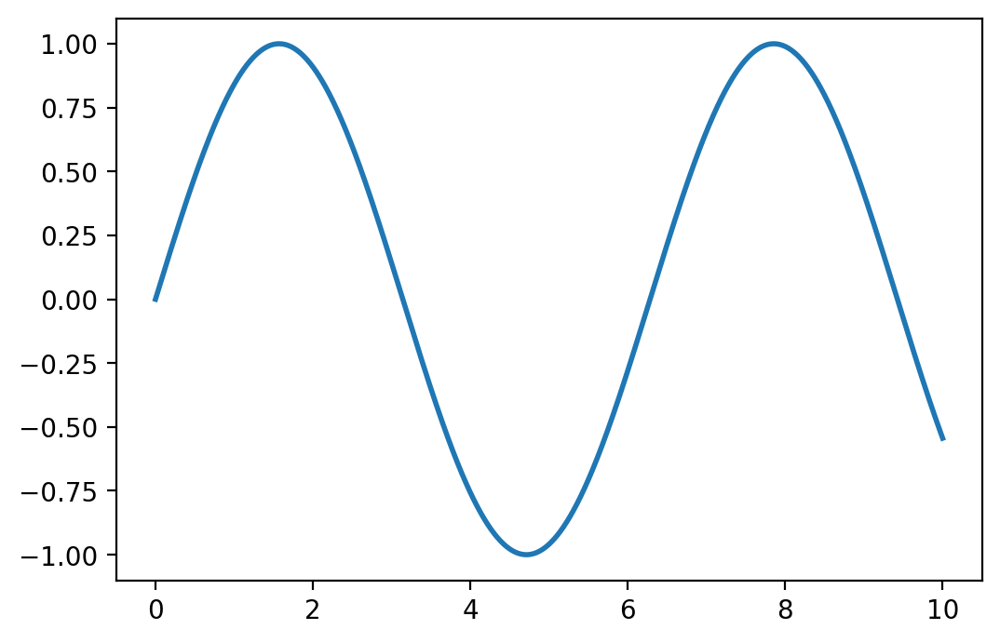

In [7]:
data, t = gen_data(f, time, samples)
plot_data(data, t, marker='', linewidth=2)

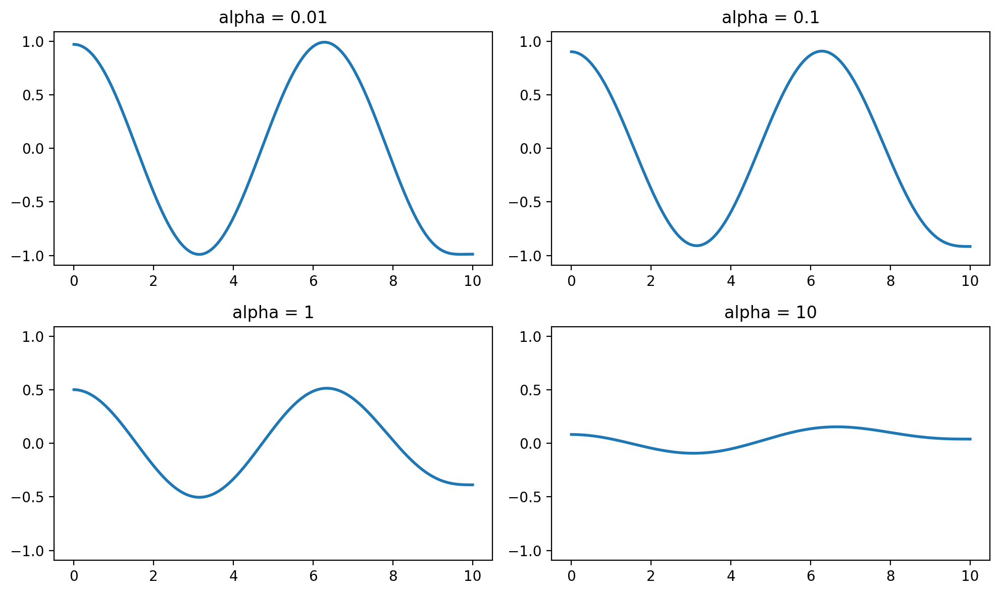

In [8]:
data, t = gen_data(f, time, samples)
fast_tvr = FastTVR()
fig = plt.figure(figsize=(10, 6))
alpha = [0.01, 0.1, 1, 10]
xlim, ylim = None, None
for i, value in enumerate(alpha, 1):
    ax = fig.add_subplot(2, 2, i)
    fast_tvr.set_params(alpha = value)
    dif = fast_tvr.transform(data, t)
    ax.set_title(f'alpha = {value}')
    plot_data(dif, t, ax=ax, xlim=xlim, ylim=ylim, marker='', linewidth=2)
    if (i == 1):
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
fig.tight_layout()
plt.show()

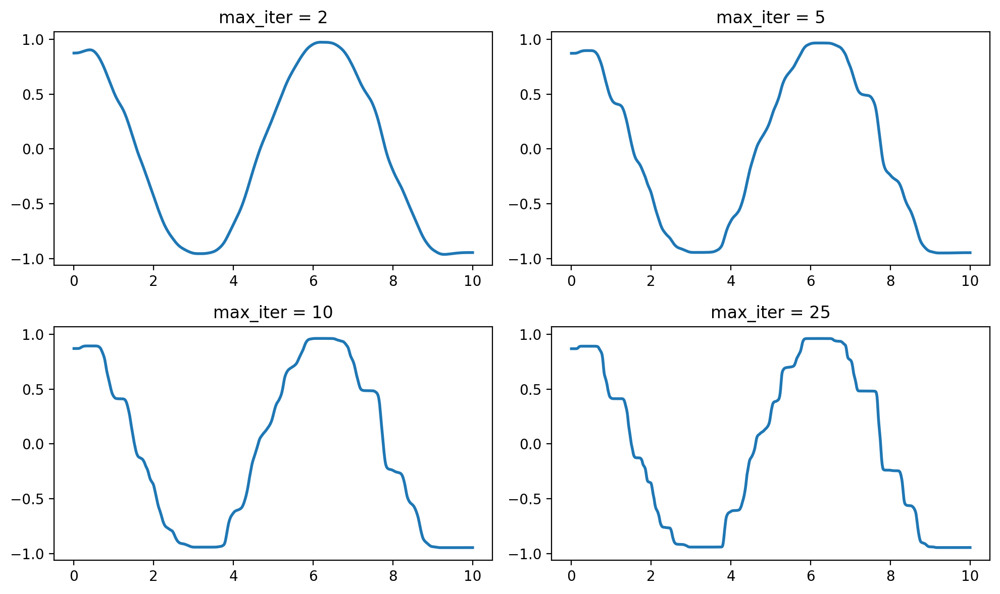

In [10]:
data, t = gen_data(f, time, samples)
data += np.random.normal(scale=0.05, size=data.shape)
tvr = TVR(alpha=0.05)
fig = plt.figure(figsize=(10, 6))
max_iter = [2, 5, 10, 25]
xlim, ylim = None, None
for i, value in enumerate(max_iter, 1):
    ax = fig.add_subplot(2, 2, i)
    tvr.set_params(max_iter = value)
    dif = tvr.transform(data, t)
    ax.set_title(f'max_iter = {value}')
    plot_data(dif, t, ax=ax, xlim=xlim, ylim=ylim, marker='', linewidth=2)
    if (i == 1):
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
fig.tight_layout()
plt.show()

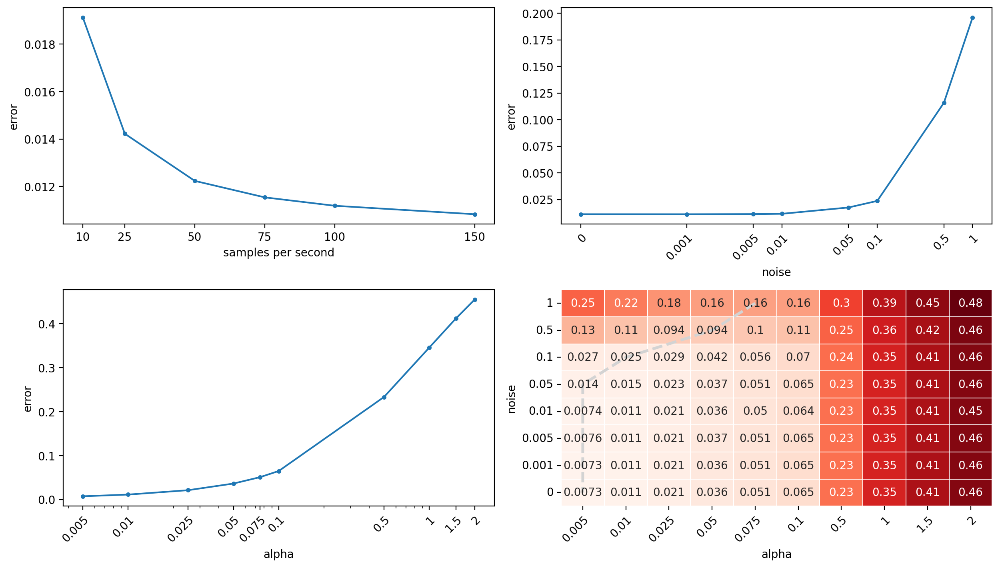

In [11]:
plot_dif_test_fasttvr(f, time, samples, [0.005, 0.01, 0.025, 0.05, 0.075, 0.1, 0.5, 1, 1.5, 2], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1], 
                      [10, 25, 50, 75, 100, 150], rotate_alpha=True, rotate_noise=True, repeat=10, alpha=0.01)

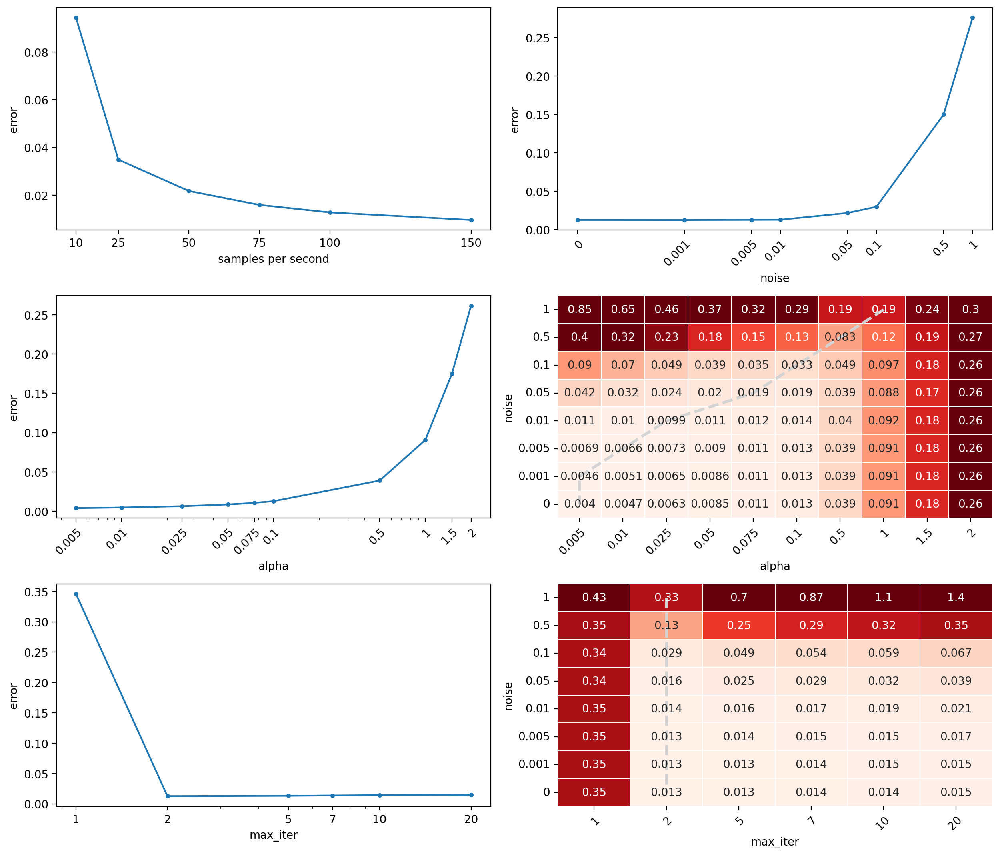

In [22]:
plot_dif_test_tvr(f, time, samples, [0.005, 0.01, 0.025, 0.05, 0.075, 0.1, 0.5, 1, 1.5, 2], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1], 
                  [10, 25, 50, 75, 100, 150], [1, 2, 5, 7, 10, 20], rotate_alpha=True, rotate_noise=True, repeat=3, alpha_vmax=0.25, max_iter_vmax=0.4, alpha=0.1, max_iter=2)

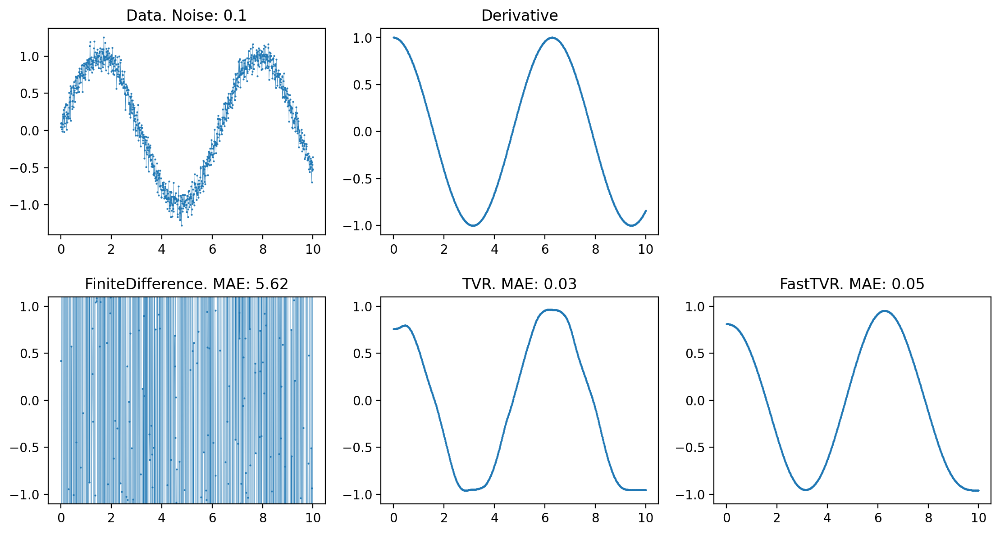

In [21]:
plot_dif_test(f, time, samples, [FiniteDifference(), TVR(max_iter=2, alpha=0.1), FastTVR(0.05)], noise=0.1, size=(4.5, 3.5))

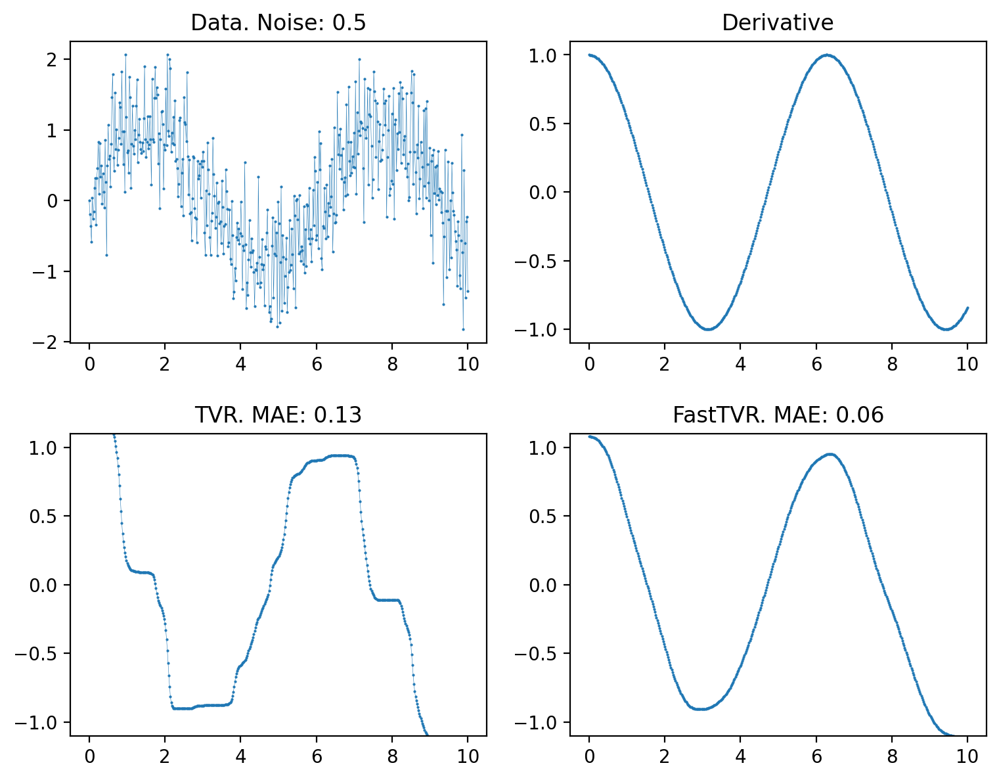

In [8]:
plot_dif_test(f, (0, 10), 50, [TVR(max_iter=10, alpha=0.5), FastTVR(0.05)], noise=0.5, size=(4.5, 3.5))

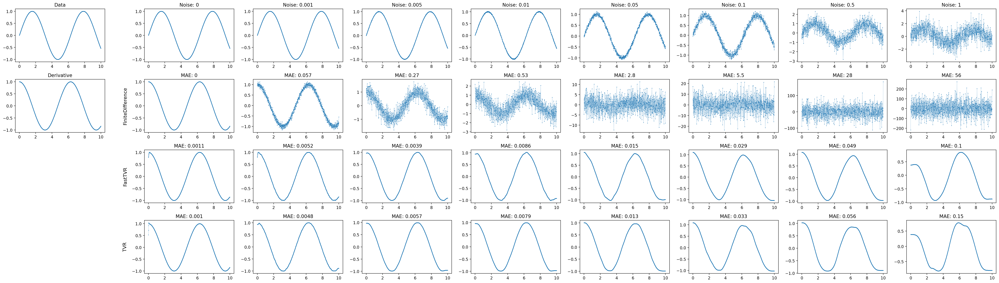

In [14]:
plot_dif_results(f, time, samples, [FiniteDifference(), FastTVR(), TVR()], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1],
                 [[], 
                  [dict(alpha=1e-6), dict(alpha=1e-6), dict(alpha=1e-4), dict(alpha=1e-4), dict(alpha=1e-3), dict(alpha=0.01), dict(alpha=0.06), dict(alpha=0.1)], 
                  [dict(alpha=1e-6), dict(alpha=1e-4), dict(alpha=0.01), dict(alpha=0.025), dict(alpha=0.075), dict(alpha=0.1), dict(alpha=0.6), dict(alpha=1)]],
                 verbose = True)

## Модуль

In [12]:
f = lambda t: np.abs(t)
time = (-1, 1)
samples = 100

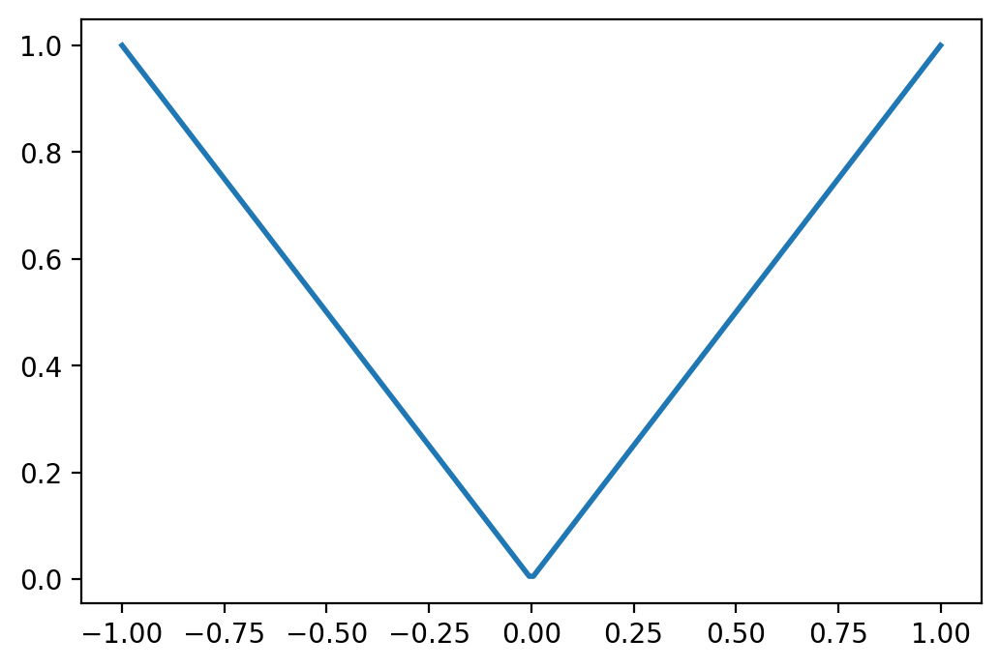

In [13]:
data, t = gen_data(f, time, samples)
plot_data(data, t, marker='', linewidth=2)

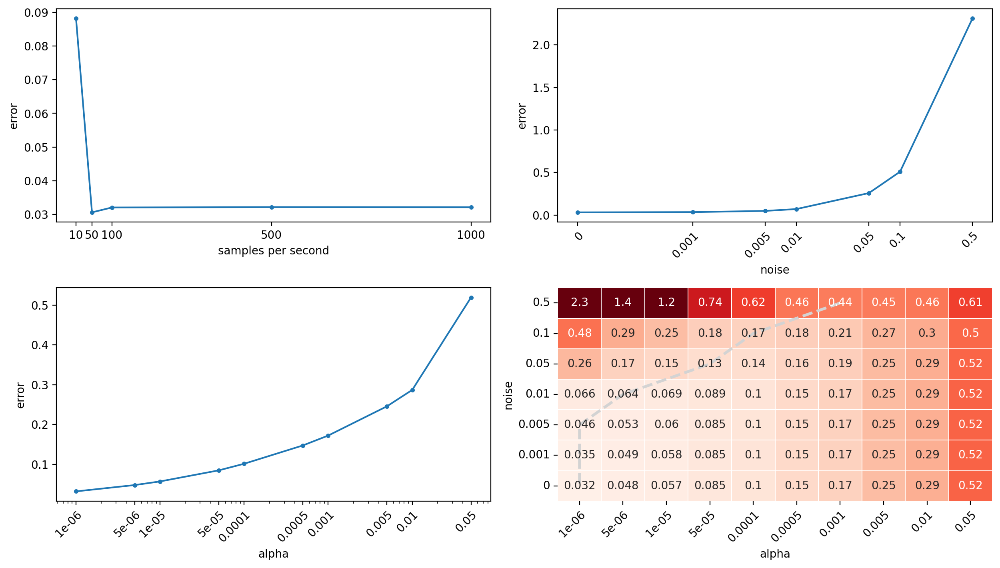

In [9]:
plot_dif_test_fasttvr(f, time, samples, [1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4, 0.001, 0.005, 0.01, 0.05], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5], 
                      [10, 50, 100, 500, 1000], rotate_alpha=True, rotate_noise=True, repeat=10, vmax=1, alpha=1e-6)

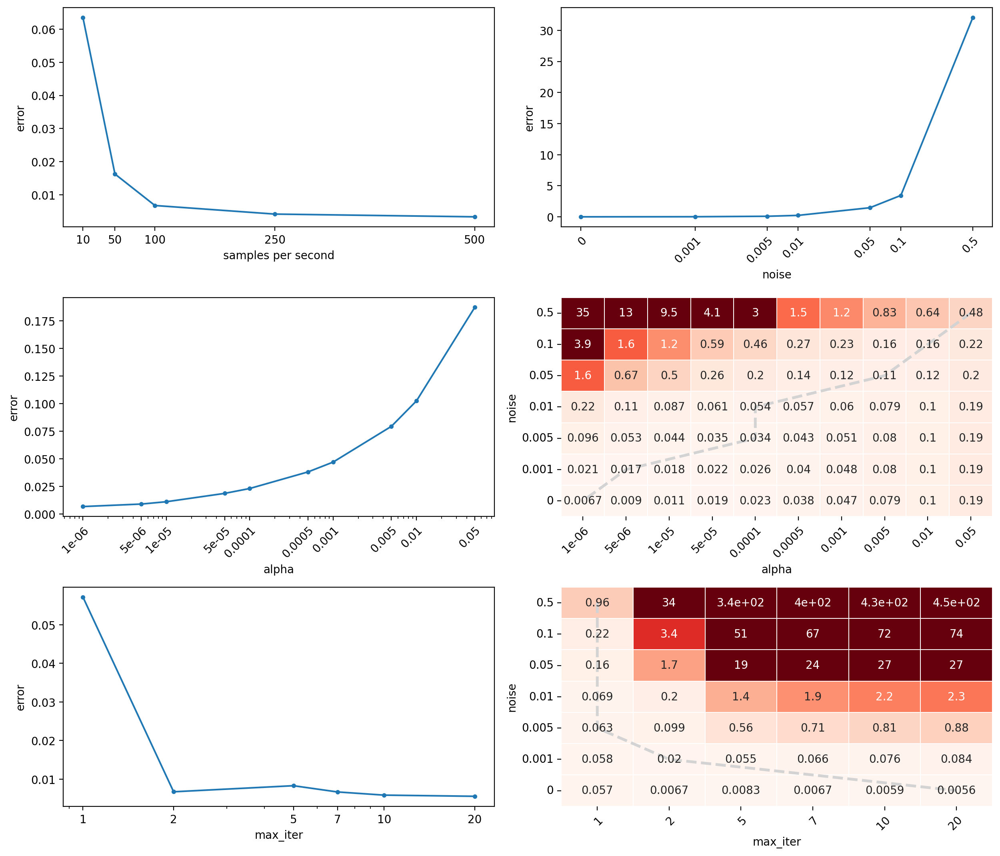

In [10]:
plot_dif_test_tvr(f, time, samples, [1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4, 0.001, 0.005, 0.01, 0.05], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5], 
                  [10, 50, 100, 250, 500], [1, 2, 5, 7, 10, 20], rotate_alpha=True, rotate_noise=True, repeat=3, alpha_vmax=3, max_iter_vmax=5, alpha=1e-6, max_iter=2)

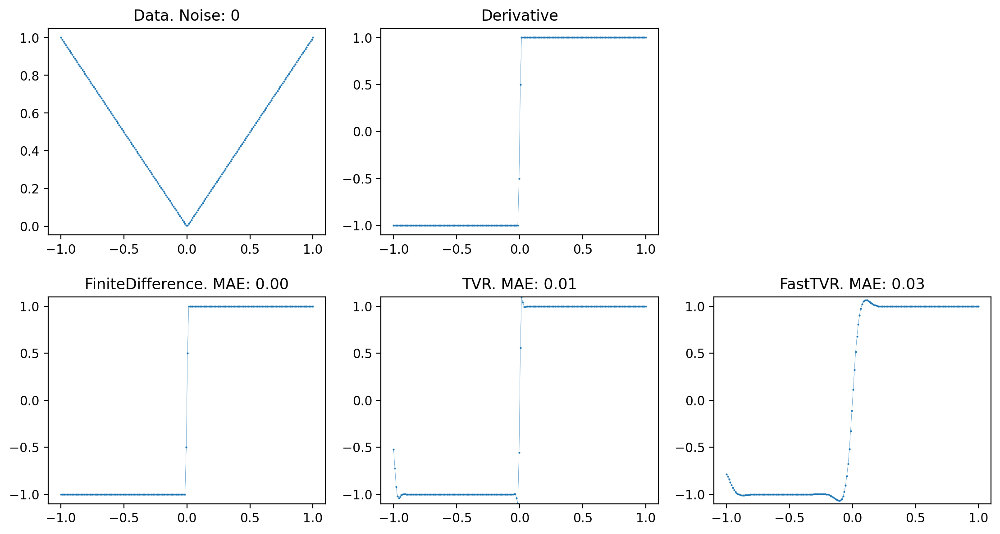

In [17]:
plot_dif_test(f, (-1, 1), 100, [FiniteDifference(), TVR(max_iter=2, alpha=1e-6), FastTVR(1e-6)], noise=0, size=(4.5, 3.5))

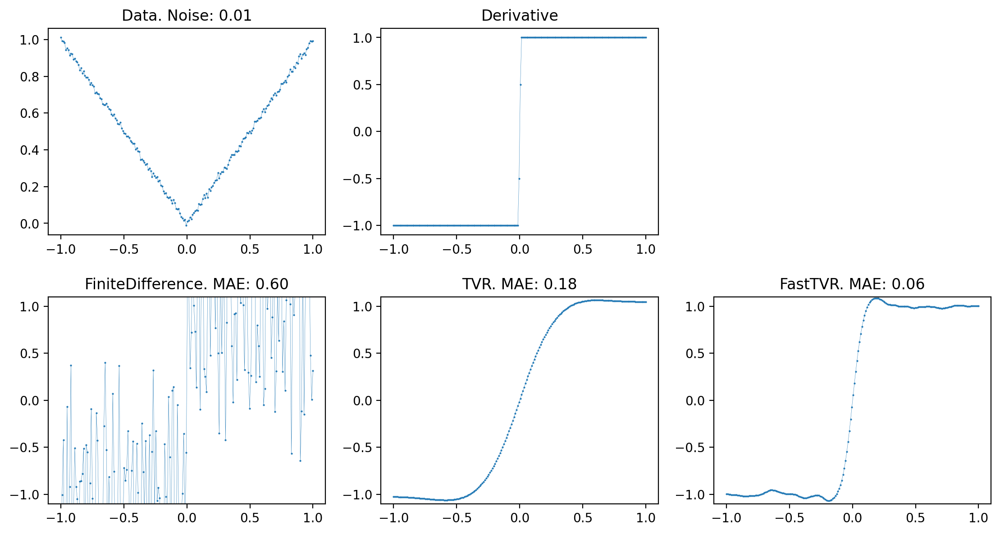

In [16]:
plot_dif_test(f, (-1, 1), 100, [FiniteDifference(), TVR(max_iter=1, alpha=1e-4), FastTVR(1e-5)], noise=0.01, size=(4.5, 3.5))

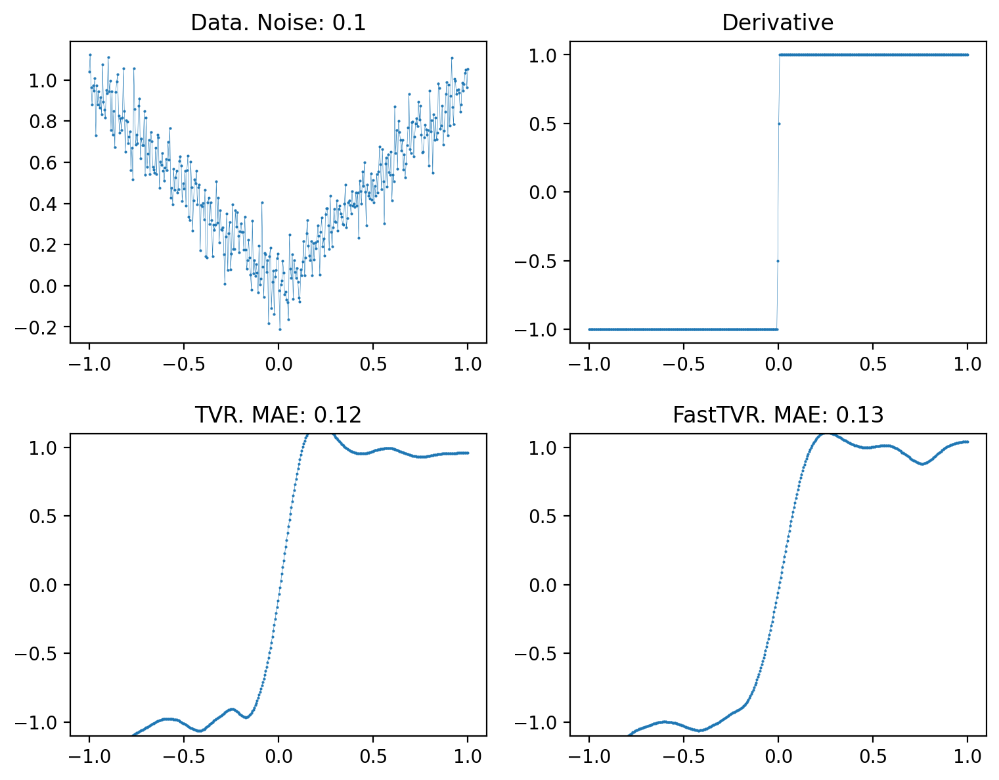

In [20]:
plot_dif_test(f, (-1, 1), 200, [TVR(max_iter=2, alpha=1e-2), FastTVR(1e-4)], noise=0.1, size=(4.5, 3.5))

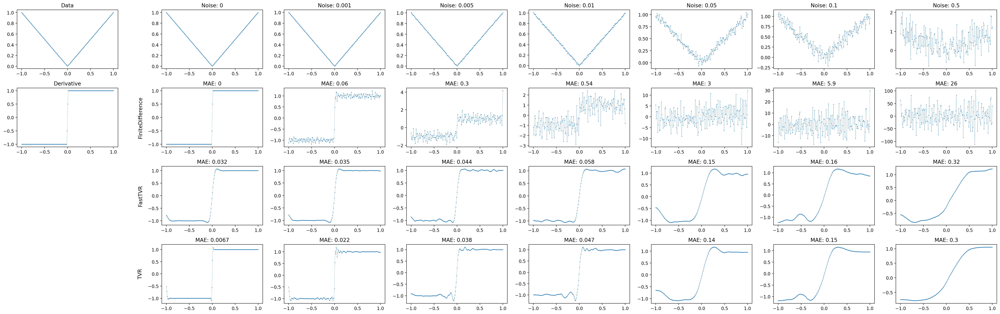

In [20]:
plot_dif_results(f, time, samples, [FiniteDifference(), FastTVR(), TVR()], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5],
                 [[], 
                  [dict(alpha=1e-6), dict(alpha=1e-6), dict(alpha=1e-6), dict(alpha=5e-6), dict(alpha=5e-5), dict(alpha=1e-4), dict(alpha=1e-3)], 
                  [dict(alpha=1e-6), dict(alpha=1e-6), dict(alpha=5e-5), dict(alpha=1e-4), dict(alpha=5e-3), dict(alpha=1e-2), dict(alpha=5e-2)]],
                 verbose = True)

## Аттрактор Лоренца

In [14]:
time = (0, 20)
samples = 100
data, t = gen_data(odes.lorenz_attractor, time, samples, odes.lorenz_attractor.u0)

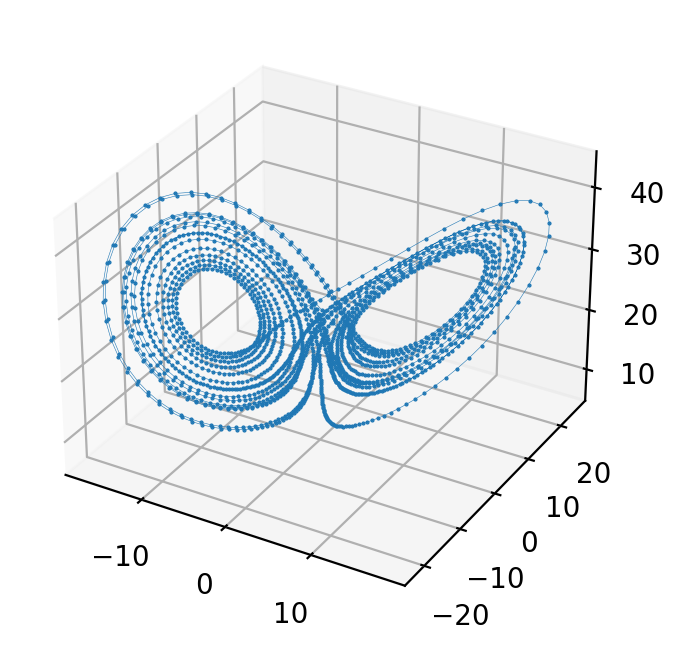

In [17]:
plot_data(data, t)

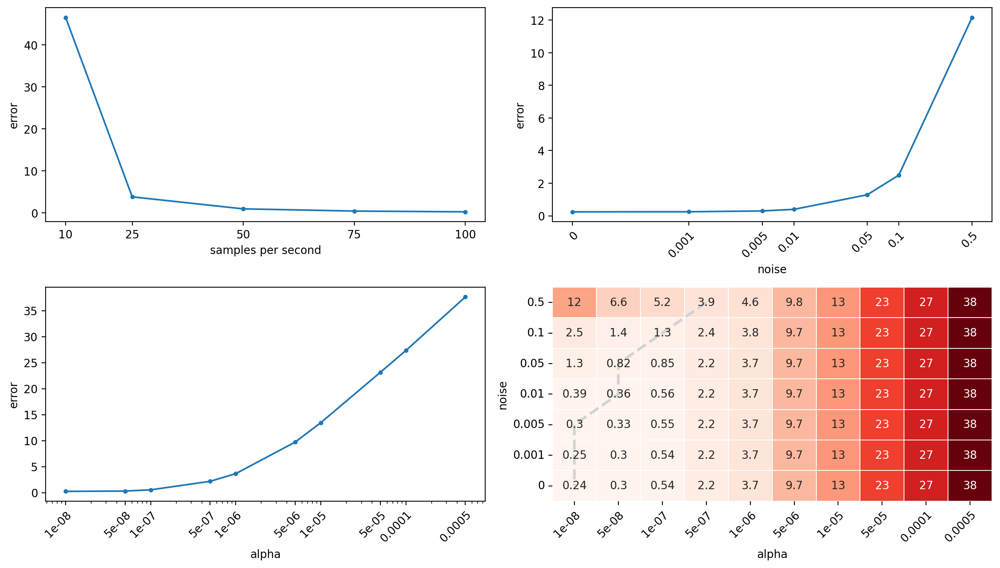

In [12]:
plot_dif_test_fasttvr(odes.lorenz_attractor, time, samples, [1e-8, 5e-8, 1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5], 
                      [10, 25, 50, 75, 100], rotate_alpha=True, rotate_noise=True, repeat=1, alpha=1e-8, u0=odes.lorenz_attractor.u0)

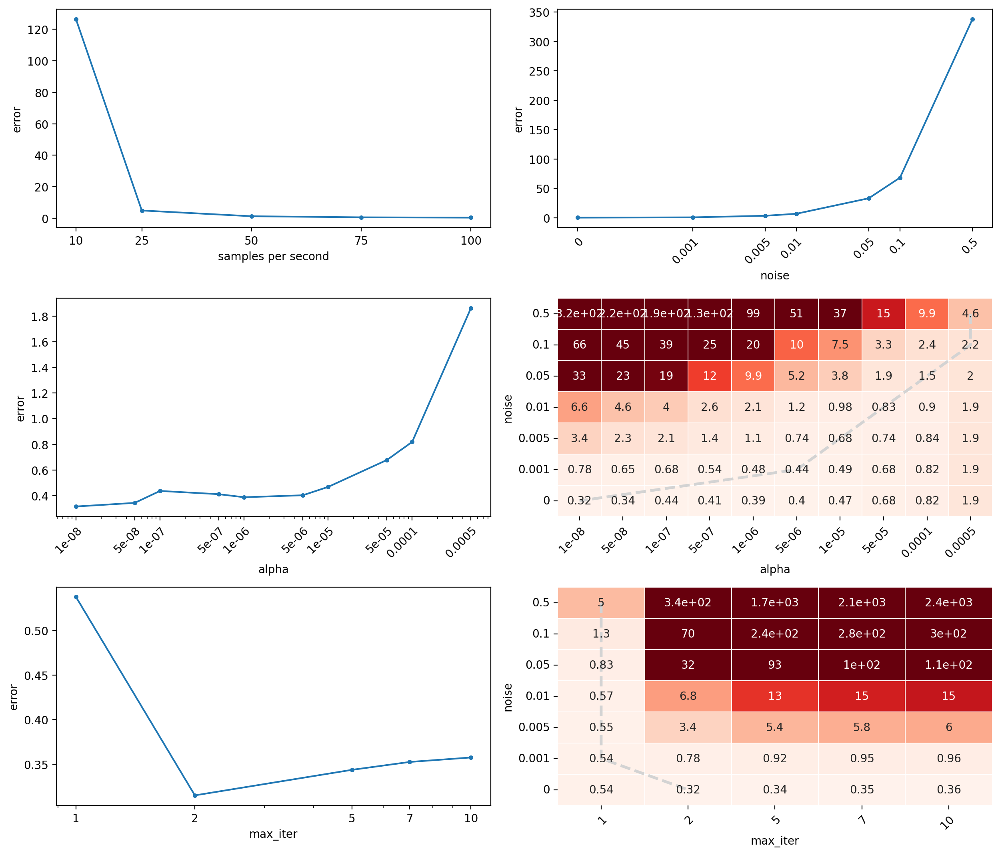

In [13]:
plot_dif_test_tvr(odes.lorenz_attractor, time, samples, [1e-8, 5e-8, 1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5], 
                  [10, 25, 50, 75, 100], [1, 2, 5, 7, 10], rotate_alpha=True, rotate_noise=True, repeat=1, alpha_vmax=20, max_iter_vmax=20, u0=odes.lorenz_attractor.u0, max_iter=2, alpha=1e-8)

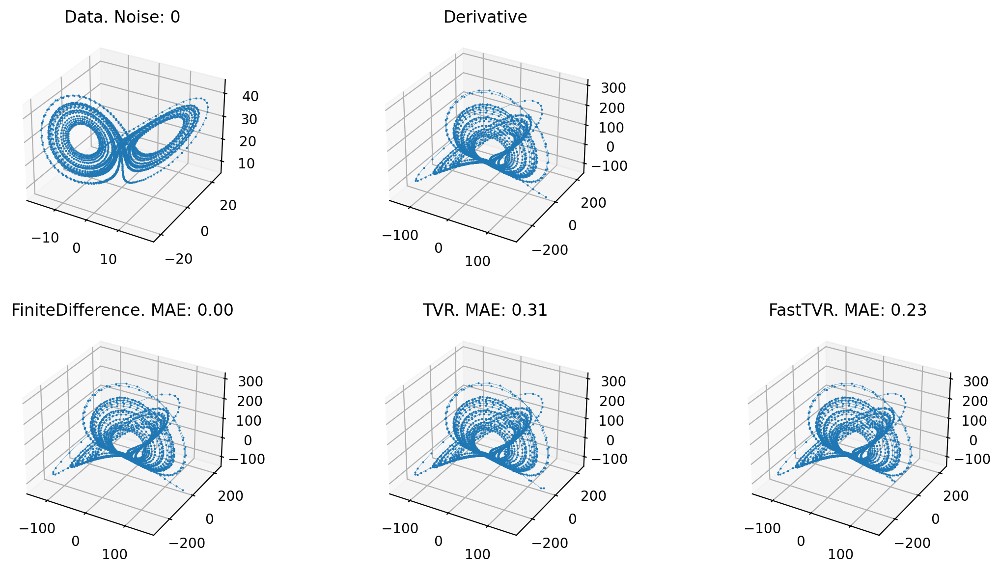

In [8]:
plot_dif_test(data, time, samples, [FiniteDifference(), TVR(max_iter=2, alpha=1e-8), FastTVR(1e-8)], noise=0, size=(4.5, 3.5))

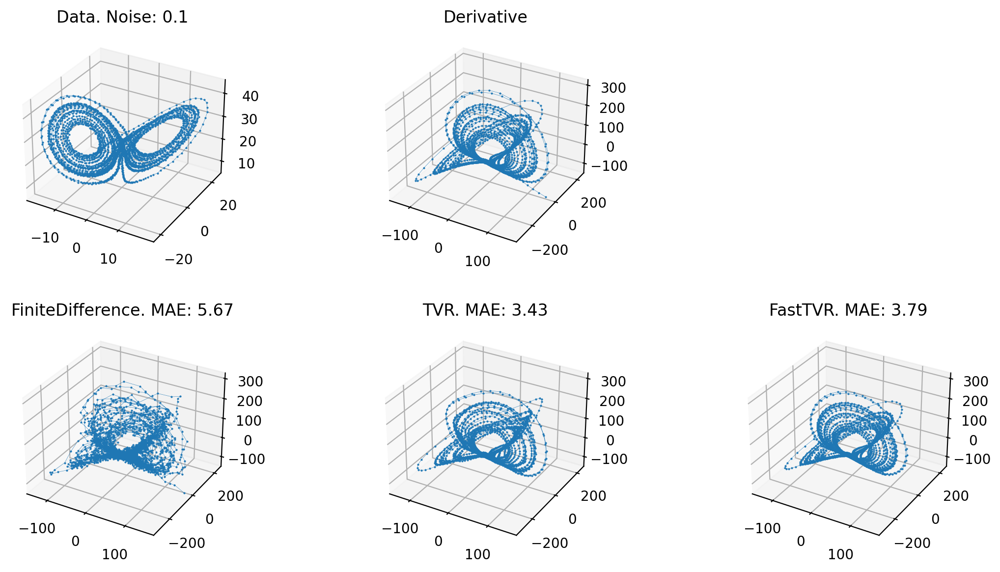

In [13]:
plot_dif_test(data, time, samples, [FiniteDifference(), TVR(max_iter=2, alpha=1e-3), FastTVR(1e-6)], noise=0.1, size=(4.5, 3.5))

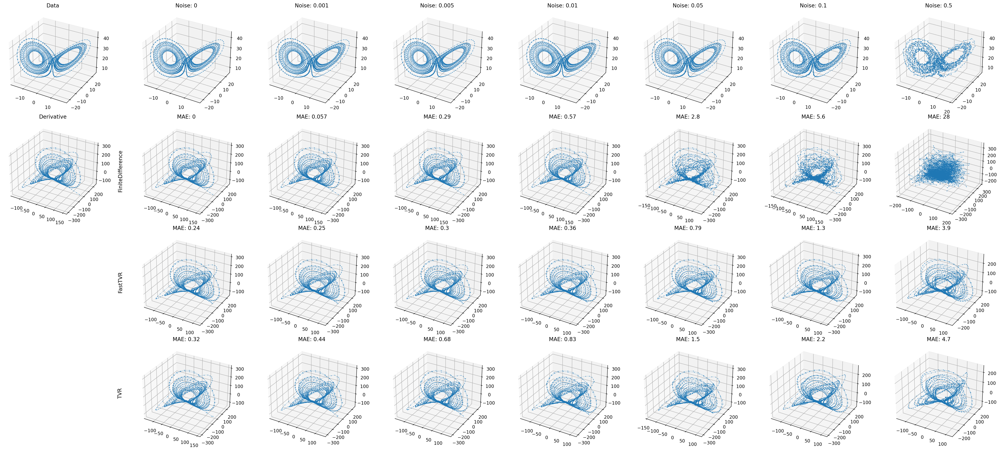

In [24]:
plot_dif_results(data, time, samples, [FiniteDifference(), FastTVR(), TVR()], [0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5],
                 [[], 
                  [dict(alpha=1e-8), dict(alpha=1e-8), dict(alpha=1e-8), dict(alpha=5e-8), dict(alpha=5e-8), dict(alpha=1e-7), dict(alpha=5e-7)], 
                  [dict(alpha=1e-8), dict(alpha=5e-6), dict(alpha=1e-5), dict(alpha=5e-5), dict(alpha=1e-4), dict(alpha=5e-4), dict(alpha=1e-3)]],
                 size=(3.5, 3.5), verbose = True)

## Общие выводы

### Замер времени

In [ ]:
import time
import tqdm

f = lambda t: np.sin(t)
samples = [10, 20, 30, 40, 50, 70, 80, 100, 150, 200, 250, 500, 750, 1000, 2500, 5000, 7500, 10000]

tvr = TVR(0.01, 2)
fast_tvr = FastTVR(0.01)
tvr_time = []
fast_tvr_time = []
for s in tqdm.tqdm(samples):
    data, t = gen_data(f, (0, 1), s)
    
    repeat = 1000 if s < 100 else (200 if s < 500 else (50 if s < 1000 else (10 if s < 5000 else 1)))
    tvr_time.append(0)
    fast_tvr_time.append(0)
    for _ in range(repeat):
        start = time.time()
        tvr.transform(data, t)
        end = time.time()
        tvr_time[-1] += (end - start)
    
        start = time.time()
        fast_tvr.transform(data, t)
        end = time.time()
        fast_tvr_time[-1] += (end - start)
        
    tvr_time[-1] /= repeat
    fast_tvr_time[-1] /= repeat

100%|██████████████████████████████████████████████████████████████████████████████████| 18/18 [10:00<00:00, 33.38s/it]


In [ ]:
print(tvr_time)
print(fast_tvr_time)

[0.00024332880973815919, 0.000695551872253418, 0.0011458427906036377, 0.0016196250915527343, 0.002614197254180908, 0.003980179786682129, 0.004851796627044678, 0.00713254451751709, 0.011842571496963501, 0.01825556516647339, 0.026442861557006835, 0.1038651704788208, 0.2636073350906372, 0.520383644104004, 4.589974784851075, 28.810550928115845, 106.81481957435608, 217.02877712249756]
[9.909343719482422e-05, 0.00031268501281738284, 0.0005957403182983398, 0.0008432950973510742, 0.001402078628540039, 0.002157679796218872, 0.002536679983139038, 0.003332904577255249, 0.006961045265197754, 0.01061416506767273, 0.014702050685882569, 0.051577086448669436, 0.12081581592559815, 0.23238954544067383, 1.7790001392364503, 10.353168964385986, 30.11989140510559, 66.46953344345093]


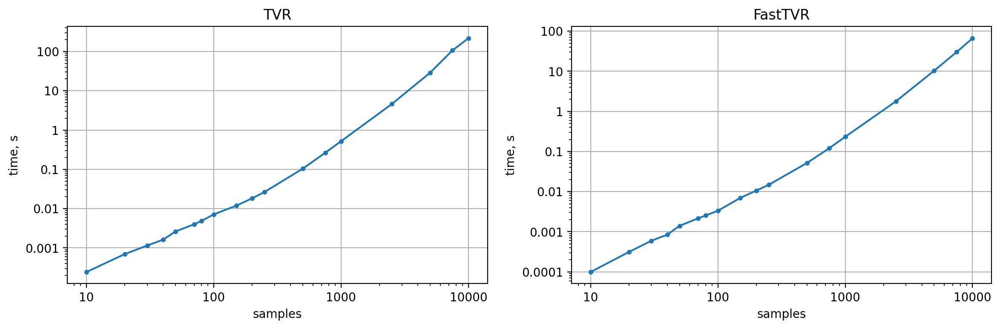

In [ ]:
fig = plt.figure(figsize=(14, 4))
axes = fig.subplots(1, 2)

axes[0].set(xscale='log', yscale='log', xlabel='samples', ylabel='time, s', title='TVR')
axes[0].get_xaxis().set_major_formatter('{x:n}')
axes[0].get_yaxis().set_major_formatter('{x:n}')
axes[0].plot(samples, tvr_time, marker='.')
axes[0].grid(True)

axes[1].set(xscale='log', yscale='log', xlabel='samples', ylabel='time, s', title='FastTVR')
axes[1].get_xaxis().set_major_formatter('{x:n}')
axes[1].get_yaxis().set_major_formatter('{x:n}')
axes[1].plot(samples, fast_tvr_time, marker='.')
axes[1].grid(True)
plt.show()

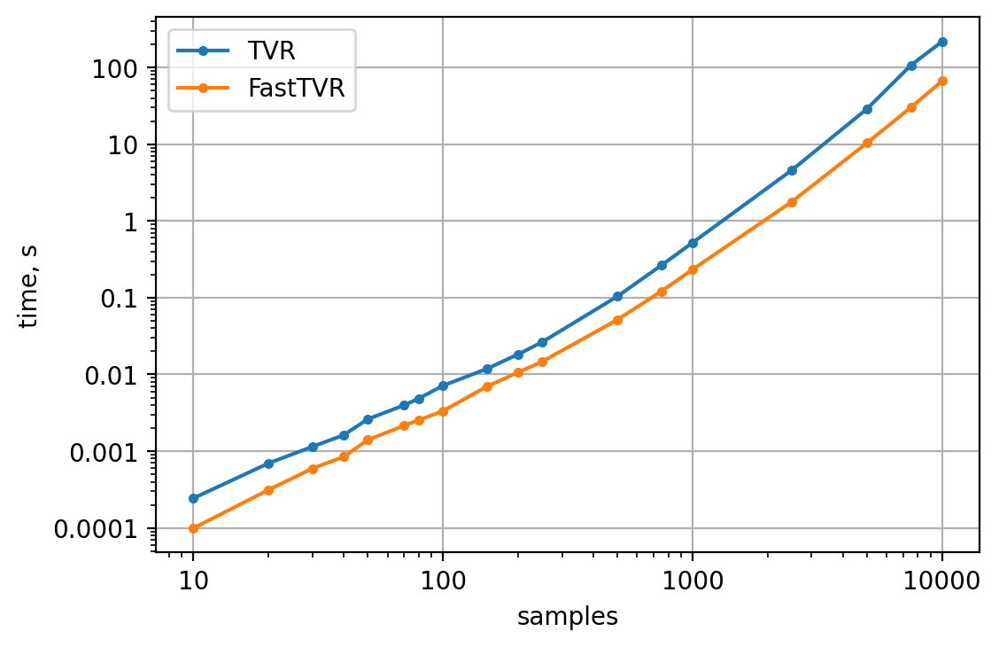

In [ ]:
plt.gca().set(xscale='log', yscale='log', xlabel='samples', ylabel='time, s')
plt.gca().get_xaxis().set_major_formatter('{x:n}')
plt.gca().get_yaxis().set_major_formatter('{x:n}')
plt.plot(samples, tvr_time, marker='.', label='TVR')
plt.plot(samples, fast_tvr_time, marker='.', label='FastTVR')
plt.grid(True)
plt.legend()
plt.show()

### Зависимость между уровнем шума и параметром

In [5]:
from collections import defaultdict

noise = np.array([0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5])
alpha = np.array([1e-8, 5e-8, 1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4, 0.005, 0.01, 0.025, 0.05, 0.075, 0.1, 0.5])

functions = [
    (np.sin, (0, 10), 100, None),
    (np.abs, (-1, 1), 200, None),
    (odes.lorenz_attractor, (0, 20), 100, odes.lorenz_attractor.u0),
    (odes.linear, (0, 25), 50, odes.linear.u0),
    (odes.linear, (0, 2.5), 200, (10, 10)),
    (odes.van_der_pol, (0, 100), 20, odes.van_der_pol.u0),
    (odes.torus, (0, 200), 10, odes.torus.u0),
    (odes.moore_spiegel, (0, 200), 10, odes.moore_spiegel.u0),
    (odes.aritmic, (500, 650), 15, odes.aritmic.u0)
]

args = defaultdict(list,
    linear=(-1, 20, -20, -1)
)

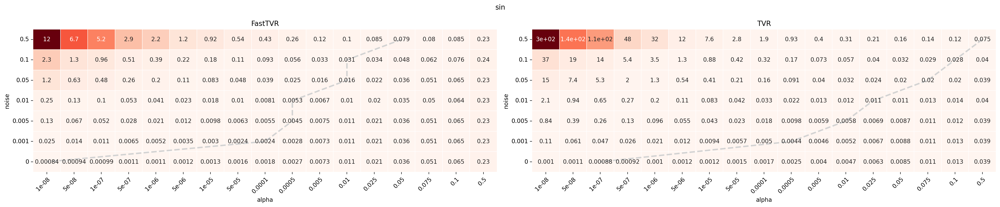

[1.e-08 1.e-04 5.e-04 5.e-04 1.e-02 1.e-02 5.e-02]
[1.0e-07 5.0e-04 1.0e-02 2.5e-02 7.5e-02 1.0e-01 5.0e-01]


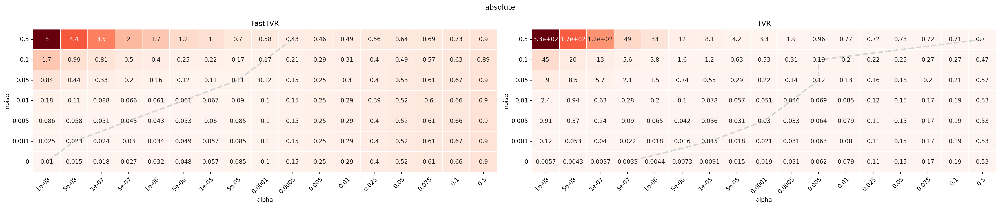

[1.e-08 5.e-08 5.e-07 5.e-06 5.e-05 1.e-04 5.e-04]
[5.e-07 1.e-05 1.e-04 5.e-04 5.e-03 5.e-03 5.e-01]


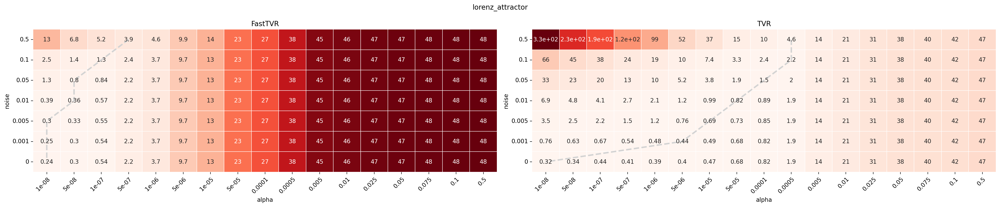

[1.e-08 1.e-08 1.e-08 5.e-08 5.e-08 1.e-07 5.e-07]
[1.e-08 5.e-06 1.e-05 5.e-05 1.e-04 5.e-04 5.e-04]


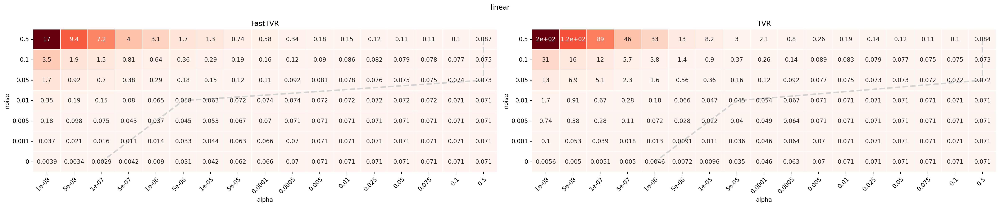

[1.e-07 5.e-07 1.e-06 5.e-06 5.e-01 5.e-01 5.e-01]
[1.e-06 5.e-06 1.e-05 5.e-05 5.e-01 5.e-01 5.e-01]


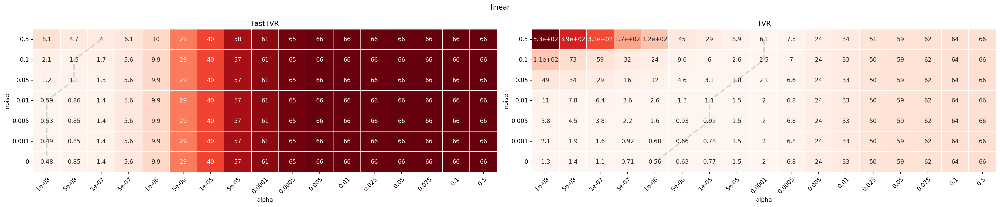

[1.e-08 1.e-08 1.e-08 1.e-08 5.e-08 5.e-08 1.e-07]
[1.e-06 5.e-06 1.e-05 1.e-05 5.e-05 1.e-04 1.e-04]


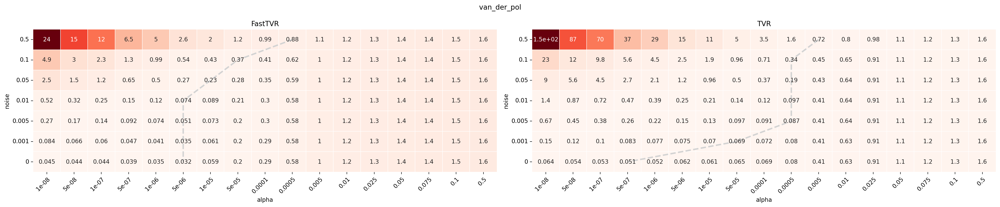

[5.e-06 5.e-06 5.e-06 5.e-06 1.e-05 5.e-05 5.e-04]
[5.e-07 5.e-05 5.e-04 5.e-04 5.e-04 5.e-04 5.e-03]


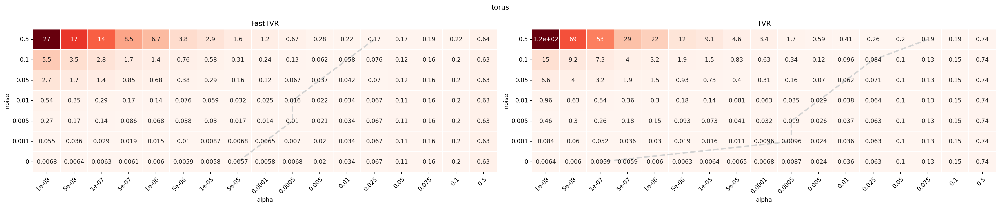

[5.0e-05 1.0e-04 5.0e-04 5.0e-04 5.0e-03 1.0e-02 2.5e-02]
[1.0e-07 5.0e-04 5.0e-04 5.0e-03 1.0e-02 2.5e-02 7.5e-02]


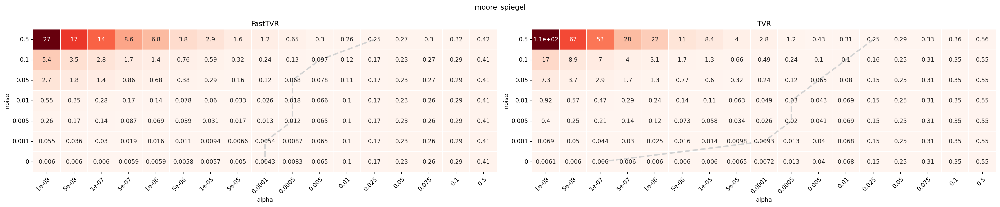

[0.0001 0.0001 0.0005 0.0005 0.0005 0.005  0.025 ]
[1.0e-07 1.0e-04 5.0e-04 5.0e-04 5.0e-03 1.0e-02 2.5e-02]


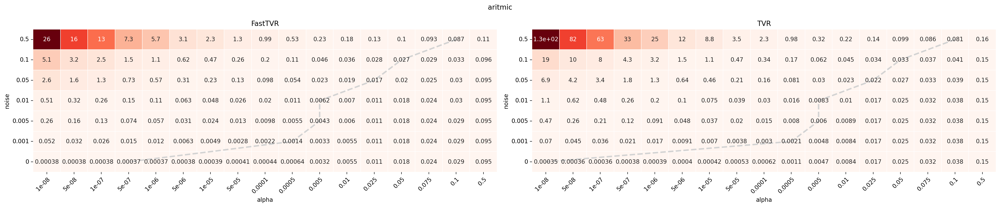

[5.0e-07 5.0e-04 5.0e-03 5.0e-03 2.5e-02 5.0e-02 1.0e-01]
[1.0e-08 5.0e-04 5.0e-03 5.0e-03 2.5e-02 5.0e-02 1.0e-01]


In [14]:
min_error_alpha_tvr = list()
min_error_alpha_fast_tvr = list()
diameter = list()

tvr = TVR()
fast_tvr = FastTVR()

for f, time, samples, u0 in functions:
    fig = plt.figure(figsize=(24, 5))
    ax = fig.subplots(1, 2)
    fig.suptitle(f.__name__)

    data, _ = gen_data(f, time, samples, u0, args=args[f.__name__])
    diameter.append((data.max(axis=0) - data.min(axis=0)).max())

    ax[0].set_title('FastTVR')
    error = plot_dif_test_arg_noise(data, time, samples, fast_tvr, 'alpha', alpha, noise, repeat=2, return_error=True, ax=ax[0], cbar=False)
    min_error_alpha_fast_tvr.append(alpha[error.argmin(1)[::-1]])

    ax[1].set_title('TVR')
    error = plot_dif_test_arg_noise(data, time, samples, tvr, 'alpha', alpha, noise, repeat=1, return_error=True, ax=ax[1], cbar=False)
    min_error_alpha_tvr.append(alpha[error.argmin(1)[::-1]])
    
    fig.tight_layout()
    plt.show()
    print(min_error_alpha_fast_tvr[-1], min_error_alpha_tvr[-1], sep='\n')

In [15]:
print(diameter, min_error_alpha_fast_tvr, min_error_alpha_tvr, sep='\n')

[1.9999969949789154, 0.9974937343358397, 46.280311157662375, 0.2512984589042586, 25.237711147740256, 12.748951456576567, 16.600452086288392, 5.509743119471253, 2.9131369725326133]
[array([1.e-08, 1.e-04, 5.e-04, 5.e-04, 1.e-02, 1.e-02, 5.e-02]), array([1.e-08, 5.e-08, 5.e-07, 5.e-06, 5.e-05, 1.e-04, 5.e-04]), array([1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07, 5.e-07]), array([1.e-07, 5.e-07, 1.e-06, 5.e-06, 5.e-01, 5.e-01, 5.e-01]), array([1.e-08, 1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07]), array([5.e-06, 5.e-06, 5.e-06, 5.e-06, 1.e-05, 5.e-05, 5.e-04]), array([5.0e-05, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02]), array([0.0001, 0.0001, 0.0005, 0.0005, 0.0005, 0.005 , 0.025 ]), array([5.0e-07, 5.0e-04, 5.0e-03, 5.0e-03, 2.5e-02, 5.0e-02, 1.0e-01])]
[array([1.0e-07, 5.0e-04, 1.0e-02, 2.5e-02, 7.5e-02, 1.0e-01, 5.0e-01]), array([5.e-07, 1.e-05, 1.e-04, 5.e-04, 5.e-03, 5.e-03, 5.e-01]), array([1.e-08, 5.e-06, 1.e-05, 5.e-05, 1.e-04, 5.e-04, 5.e-04]), array([1.e-06, 5.

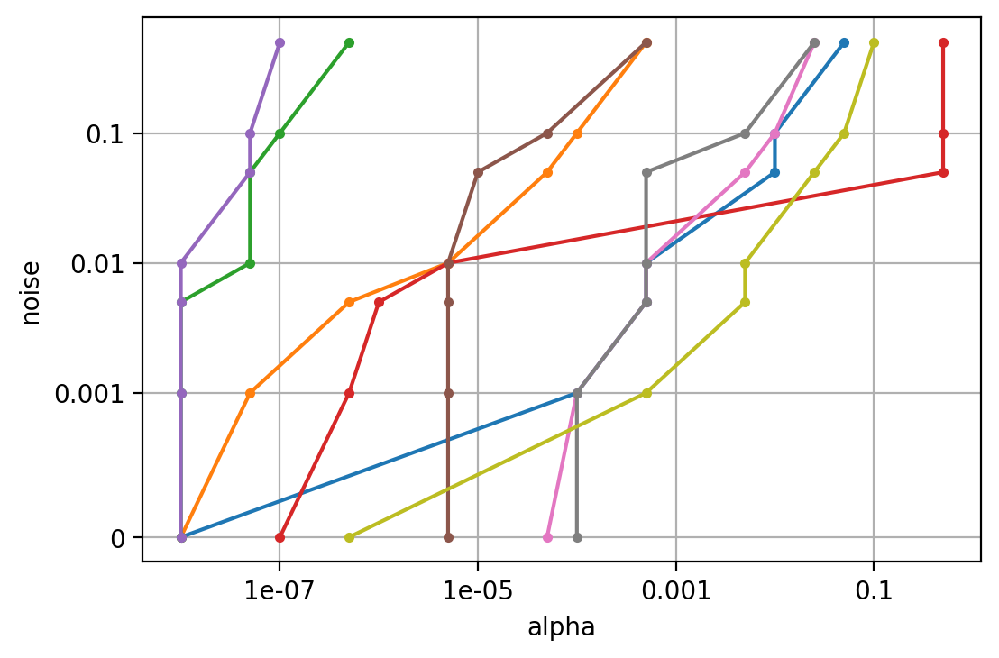

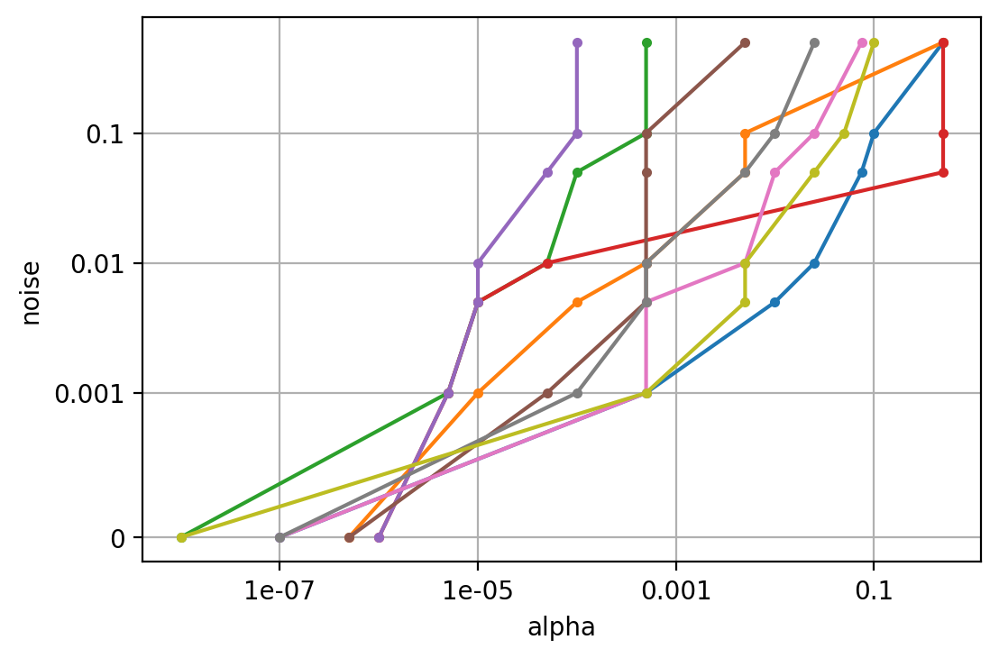

In [76]:
ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
ax.grid(True)
for values in min_error_alpha_fast_tvr:
    ax.plot(values, noise, marker='.')

plt.show()

ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
ax.grid(True)
for values in min_error_alpha_tvr:
    ax.plot(values, noise, marker='.')

plt.show()

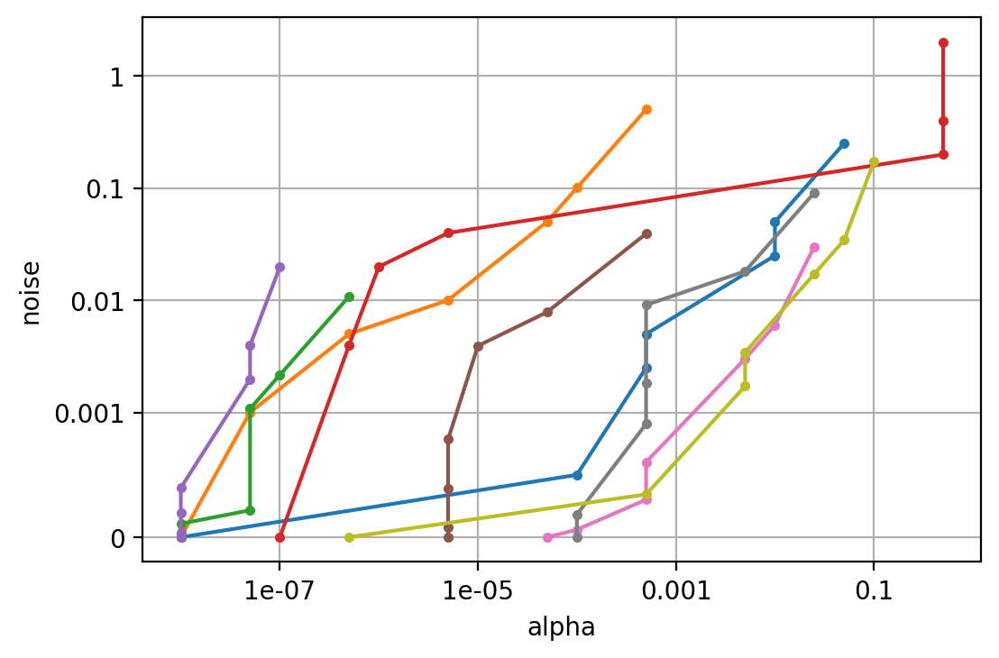

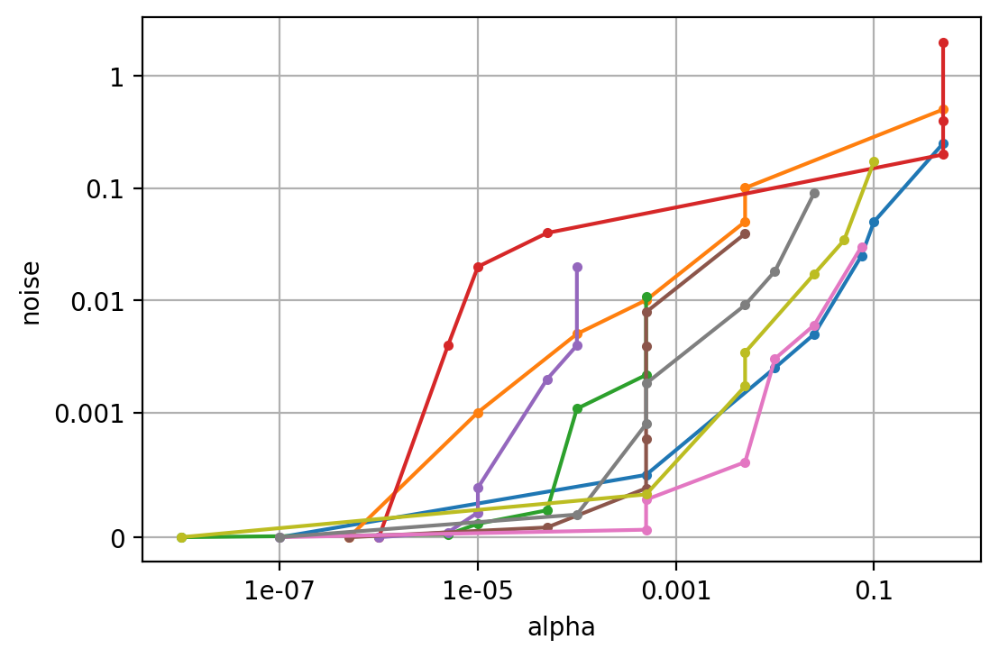

In [77]:
ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
ax.grid(True)
for d, values in zip(diameter, min_error_alpha_fast_tvr):
    ax.plot(values, noise / d, marker='.')

plt.show()

ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
ax.grid(True)
for d, values in zip(diameter, min_error_alpha_tvr):
    ax.plot(values, noise / d, marker='.')

plt.show()

In [6]:
functions += [
    (odes.fabrab, (0, 70), 20, odes.fabrab.u0),
    (odes.generator1, (0, 200), 10, odes.generator1.u0),
    (odes.generator2, (0, 100), 15, odes.generator2.u0),
    (odes.vallis, (400, 600), 10, odes.vallis.u0),
    (odes.double_scroll, (500, 700), 10, odes.double_scroll.u0),
    (odes.chua, (0, 100), 20, odes.chua.u0),
    (odes.simple_3d_model, (500, 600), 15, odes.simple_3d_model.u0)
]

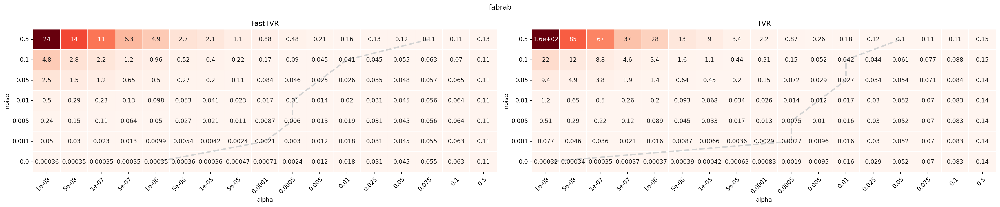

[1.0e-06 1.0e-04 5.0e-04 5.0e-04 5.0e-03 1.0e-02 7.5e-02]
[1.e-08 5.e-04 5.e-04 5.e-03 1.e-02 1.e-02 5.e-02]


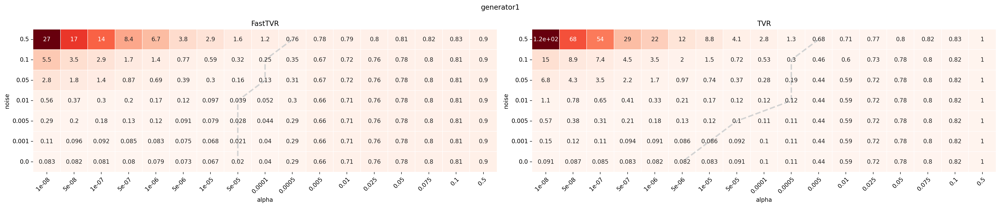

[5.e-05 5.e-05 5.e-05 5.e-05 1.e-04 1.e-04 5.e-04]
[5.e-06 1.e-05 5.e-05 5.e-04 5.e-04 5.e-04 5.e-03]


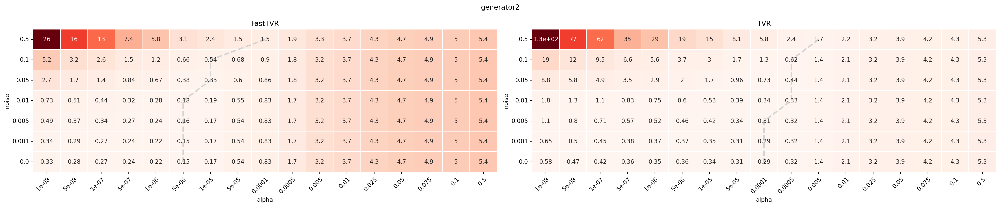

[5.e-06 5.e-06 5.e-06 5.e-06 1.e-05 1.e-05 1.e-04]
[0.0001 0.0001 0.0001 0.0005 0.0005 0.0005 0.005 ]


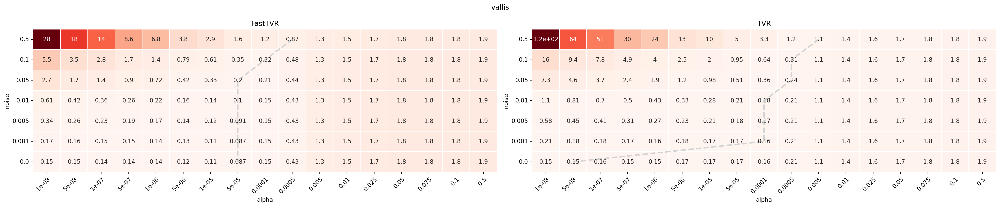

[5.e-05 5.e-05 5.e-05 5.e-05 5.e-05 1.e-04 5.e-04]
[5.e-08 1.e-04 1.e-04 1.e-04 5.e-04 5.e-04 5.e-03]


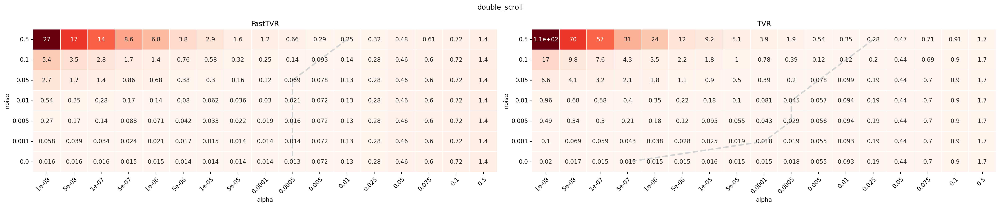

[0.0005 0.0005 0.0005 0.0005 0.0005 0.005  0.01  ]
[5.0e-07 1.0e-04 5.0e-04 5.0e-04 5.0e-03 1.0e-02 2.5e-02]


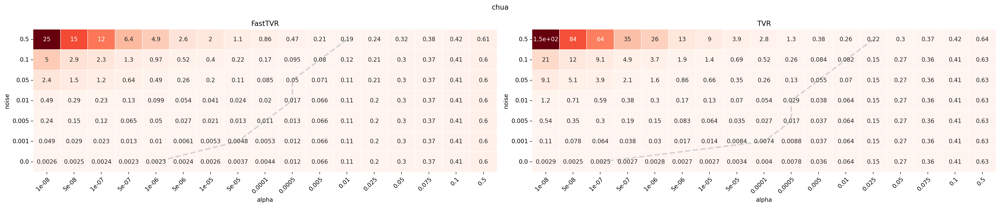

[1.e-06 5.e-05 1.e-04 5.e-04 5.e-04 5.e-03 1.e-02]
[1.0e-07 1.0e-04 5.0e-04 5.0e-04 5.0e-03 1.0e-02 2.5e-02]


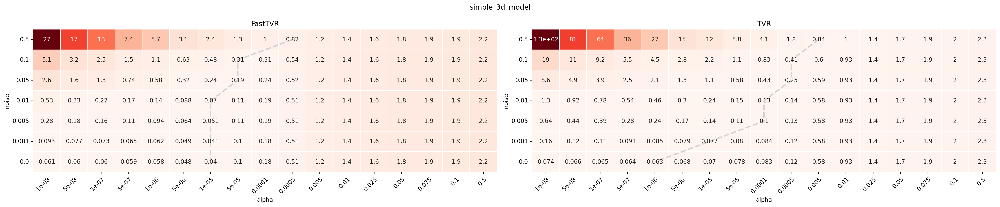

[1.e-05 1.e-05 1.e-05 1.e-05 5.e-05 5.e-05 5.e-04]
[1.e-06 1.e-05 1.e-04 1.e-04 5.e-04 5.e-04 5.e-03]


In [119]:
for f, time, samples, u0 in functions[-7:]:
    fig = plt.figure(figsize=(24, 5))
    ax = fig.subplots(1, 2)
    fig.suptitle(f.__name__)

    data, _ = gen_data(f, time, samples, u0, args=args[f.__name__])
    diameter.append((data.max(axis=0) - data.min(axis=0)).max())

    ax[0].set_title('FastTVR')
    error = plot_dif_test_arg_noise(data, time, samples, fast_tvr, 'alpha', alpha, noise, repeat=2, return_error=True, ax=ax[0], cbar=False)
    min_error_alpha_fast_tvr.append(alpha[error.argmin(1)[::-1]])

    ax[1].set_title('TVR')
    error = plot_dif_test_arg_noise(data, time, samples, tvr, 'alpha', alpha, noise, repeat=1, return_error=True, ax=ax[1], cbar=False)
    min_error_alpha_tvr.append(alpha[error.argmin(1)[::-1]])
    
    fig.tight_layout()
    plt.show()
    print(min_error_alpha_fast_tvr[-1], min_error_alpha_tvr[-1], sep='\n')

In [120]:
print(diameter, min_error_alpha_fast_tvr, min_error_alpha_tvr, sep='\n')

[1.9999969949789154, 0.9974937343358397, 46.280311157662375, 0.2512984589042586, 25.237711147740256, 12.748951456576567, 16.600452086288392, 5.509743119471253, 2.9131369725326133, 2.270077396046859, 8.379690907165955, 27.59889232397738, 19.27817920617315, 14.513286121897487, 4.465054815063651, 11.708200670683137]
[array([1.e-08, 1.e-04, 5.e-04, 5.e-04, 1.e-02, 1.e-02, 5.e-02]), array([1.e-08, 5.e-08, 5.e-07, 5.e-06, 5.e-05, 1.e-04, 5.e-04]), array([1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07, 5.e-07]), array([1.e-07, 5.e-07, 1.e-06, 5.e-06, 5.e-01, 5.e-01, 5.e-01]), array([1.e-08, 1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07]), array([5.e-06, 5.e-06, 5.e-06, 5.e-06, 1.e-05, 5.e-05, 5.e-04]), array([5.0e-05, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02]), array([0.0001, 0.0001, 0.0005, 0.0005, 0.0005, 0.005 , 0.025 ]), array([5.0e-07, 5.0e-04, 5.0e-03, 5.0e-03, 2.5e-02, 5.0e-02, 1.0e-01]), array([1.0e-06, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 7.5e-02]), array([5.e-05

In [103]:
diameter = [1.9999969949789154, 0.9974937343358397, 46.280311157662375, 0.2512984589042586, 25.237711147740256, 12.748951456576567, 16.600452086288392, 5.509743119471253, 2.9131369725326133, 2.270077396046859, 8.379690907165955, 27.59889232397738, 19.27817920617315, 14.513286121897487, 4.465054815063651, 11.708200670683137]
min_error_alpha_fast_tvr = np.array([[1.e-08, 1.e-04, 5.e-04, 5.e-04, 1.e-02, 1.e-02, 5.e-02], [1.e-08, 5.e-08, 5.e-07, 5.e-06, 5.e-05, 1.e-04, 5.e-04], [1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07, 5.e-07], [1.e-07, 5.e-07, 1.e-06, 5.e-06, 5.e-01, 5.e-01, 5.e-01], [1.e-08, 1.e-08, 1.e-08, 1.e-08, 5.e-08, 5.e-08, 1.e-07], [5.e-06, 5.e-06, 5.e-06, 5.e-06, 1.e-05, 5.e-05, 5.e-04], [5.0e-05, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02], [0.0001, 0.0001, 0.0005, 0.0005, 0.0005, 0.005 , 0.025 ], [5.0e-07, 5.0e-04, 5.0e-03, 5.0e-03, 2.5e-02, 5.0e-02, 1.0e-01], [1.0e-06, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 7.5e-02], [5.e-05, 5.e-05, 5.e-05, 5.e-05, 1.e-04, 1.e-04, 5.e-04], [5.e-06, 5.e-06, 5.e-06, 5.e-06, 1.e-05, 1.e-05, 1.e-04], [5.e-05, 5.e-05, 5.e-05, 5.e-05, 5.e-05, 1.e-04, 5.e-04], [0.0005, 0.0005, 0.0005, 0.0005, 0.0005, 0.005 , 0.01  ], [1.e-06, 5.e-05, 1.e-04, 5.e-04, 5.e-04, 5.e-03, 1.e-02], [1.e-05, 1.e-05, 1.e-05, 1.e-05, 5.e-05, 5.e-05, 5.e-04]])
min_error_alpha_tvr = np.array([[1.0e-07, 5.0e-04, 1.0e-02, 2.5e-02, 7.5e-02, 1.0e-01, 5.0e-01], [5.e-07, 1.e-05, 1.e-04, 5.e-04, 5.e-03, 5.e-03, 5.e-01], [1.e-08, 5.e-06, 1.e-05, 5.e-05, 1.e-04, 5.e-04, 5.e-04], [1.e-06, 5.e-06, 1.e-05, 5.e-05, 5.e-01, 5.e-01, 5.e-01], [1.e-06, 5.e-06, 1.e-05, 1.e-05, 5.e-05, 1.e-04, 1.e-04], [5.e-07, 5.e-05, 5.e-04, 5.e-04, 5.e-04, 5.e-04, 5.e-03], [1.0e-07, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02, 7.5e-02], [1.0e-07, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02], [1.0e-08, 5.0e-04, 5.0e-03, 5.0e-03, 2.5e-02, 5.0e-02, 1.0e-01], [1.e-08, 5.e-04, 5.e-04, 5.e-03, 1.e-02, 1.e-02, 5.e-02], [5.e-06, 1.e-05, 5.e-05, 5.e-04, 5.e-04, 5.e-04, 5.e-03], [0.0001, 0.0001, 0.0001, 0.0005, 0.0005, 0.0005, 0.005 ], [5.e-08, 1.e-04, 1.e-04, 1.e-04, 5.e-04, 5.e-04, 5.e-03], [5.0e-07, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02], [1.0e-07, 1.0e-04, 5.0e-04, 5.0e-04, 5.0e-03, 1.0e-02, 2.5e-02], [1.e-06, 1.e-05, 1.e-04, 1.e-04, 5.e-04, 5.e-04, 5.e-03]])

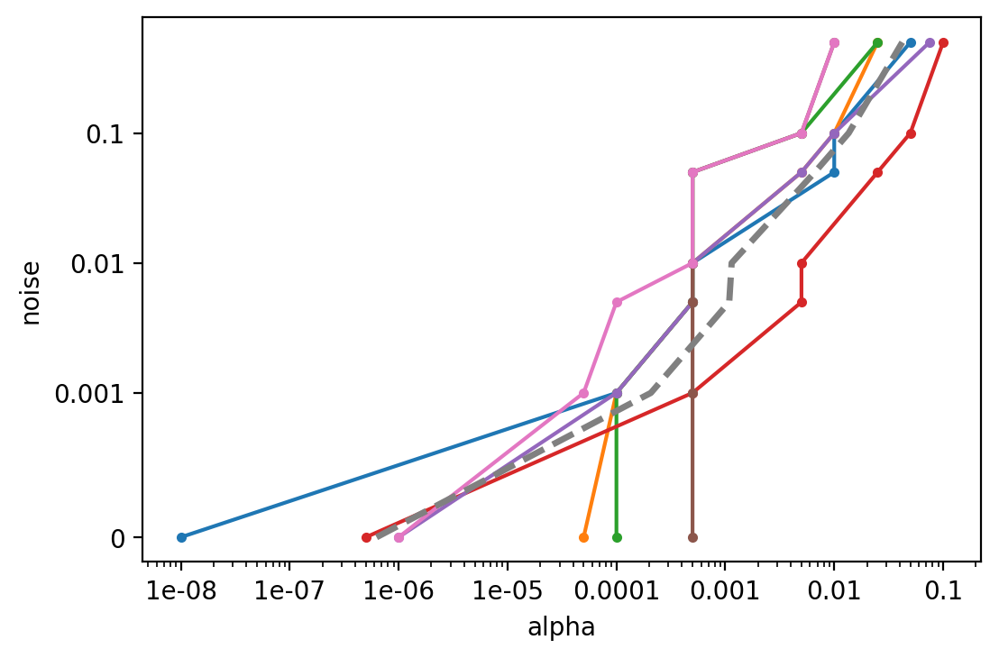

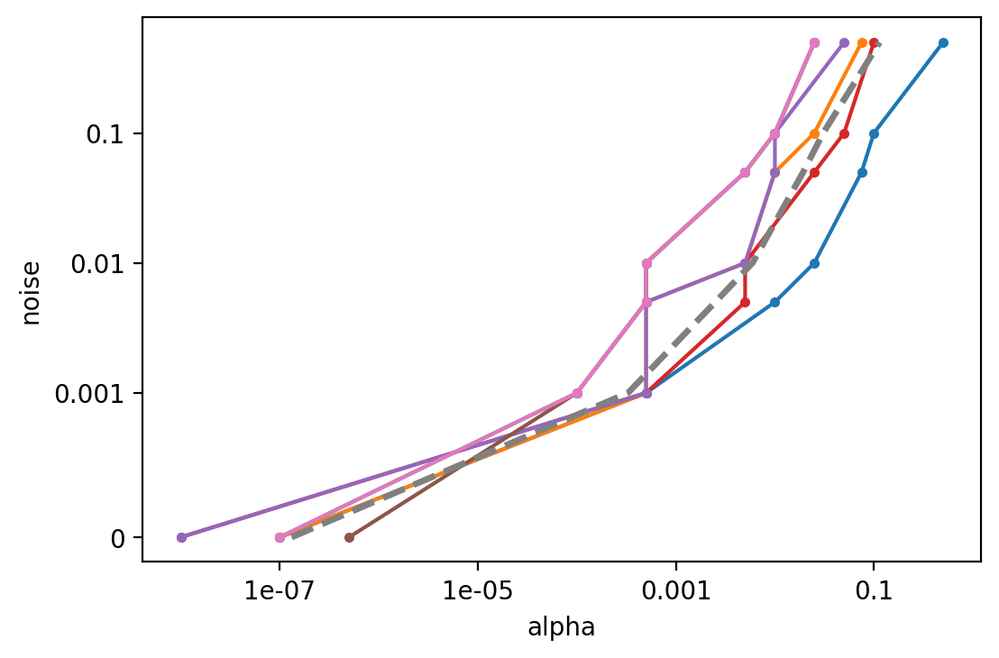

In [117]:
idx = [0, 6, 7, 8, 9, 13, 14]

ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
for i in idx:
    ax.plot(min_error_alpha_fast_tvr[i], noise, marker='.')

mean = min_error_alpha_fast_tvr[idx].mean(0)
mean[0] = min_error_alpha_fast_tvr[idx,0][min_error_alpha_fast_tvr[idx,0] < 1e-5].mean()
ax.plot(mean, noise, ls='--', lw=2.5, c='gray')

plt.show()

ax = plt.gca()
ax.set_yscale('symlog', linthresh=1e-3)
ax.set(xscale='log', ylabel='noise', xlabel='alpha')
ax.get_xaxis().set_major_formatter('{x:n}')
ax.get_yaxis().set_major_formatter('{x:n}')
for i in idx:
    ax.plot(min_error_alpha_tvr[i], noise, marker='.')

ax.plot(min_error_alpha_tvr[idx].mean(0), noise, ls='--', lw=2.5, c='gray')

plt.show()